In [1]:
import geopandas as gpd
import pandas as pd
import os
from pyproj import Geod
import numpy as np
from matplotlib import pyplot as plt
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
import folium
from tqdm import tqdm 

work_path  = "/mnt/c/Users/tandon/OneDrive - TomTom/Desktop/tomtom/Workspace/01_Rooftop_accuracy/"
alskajson = os.path.join(work_path,'USBuildingFootprints/Alaska.geojson')
hawaii_json = os.path.join(work_path,'USBuildingFootprints/Hawaii.geojson')
columbia_json = os.path.join(work_path,'USBuildingFootprints/DistrictofColumbia.geojson')

/home/tandon/anaconda3/envs/pygeo/lib/python3.8/site-packages/geopandas/_compat.py:112: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


<AxesSubplot:>

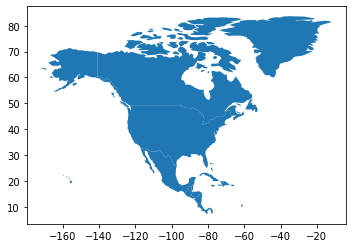

In [17]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
# make a buffer of 500km 
world = world.to_crs("epsg:4326")
world_northamerica = world.loc[world['continent']=='North America']
world_northamerica.plot() # from point to polygon

## Explore Alaska Data points from Microsoft Geojson's

In [18]:
alaska_df = gpd.read_file(alskajson)
alaska_df = gpd.GeoDataFrame(alaska_df, crs="EPSG:4326", geometry='geometry')

In [14]:
# total rectalgle area 
rectangle_bounding_box = alaska_df.total_bounds
print(rectangle_bounding_box)

[-156.77554    57.262187 -132.285007   71.363791]


In [19]:
tqdm.pandas()
# specify a named ellipsoid
geod = Geod(ellps="WGS84")

alaska_df_copy = alaska_df.copy()
# get information on the cordinate ref system
alaska_df_copy = alaska_df_copy.to_crs("epsg:4326")
# get geo area 
alaska_df_copy['area_m2'] = alaska_df_copy['geometry'].progress_apply(lambda x: abs(geod.geometry_area_perimeter(x)[0])) 
# get centroid of polygon points
alaska_df_copy['centroid'] = alaska_df_copy.geometry.centroid

print("CRS:{} NAME:{} Shape:{}".format(alaska_df_copy.crs,alaska_df_copy.crs.name,alaska_df_copy.shape[0]))
alaska_df_copy.head()

100%|██████████| 111042/111042 [00:03<00:00, 27923.83it/s]
/tmp/ipykernel_1626/3182845529.py:11: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  alaska_df_copy['centroid'] = alaska_df_copy.geometry.centroid


CRS:epsg:4326 NAME:WGS 84 Shape:111042


,release,capture_dates_range,geometry,area_m2,centroid
0,1,,"POLYGON ((-134.38645 58.27127, -134.38659 58.2...",122.147207,POINT (-134.38658 58.27125)
1,1,,"POLYGON ((-134.38884 58.27231, -134.38866 58.2...",130.519774,POINT (-134.38870 58.27233)
2,1,,"POLYGON ((-134.39264 58.27341, -134.39281 58.2...",179.161058,POINT (-134.39265 58.27333)
3,1,,"POLYGON ((-134.39556 58.27920, -134.39581 58.2...",264.550781,POINT (-134.39576 58.27922)
4,1,,"POLYGON ((-134.39701 58.27658, -134.39712 58.2...",155.701962,POINT (-134.39717 58.27655)


In [7]:
alaska_df_sample = alaska_df_copy.sample(50)
alaska_df_sample.centroid.x.map(str)
# convert point to string for reverse geocoding
alaska_df_sample['geom'] = alaska_df_sample.centroid.y.map(str)+','+alaska_df_sample.centroid.x.map(str)
# apply inverse geocoding
locator = Nominatim(user_agent='myGeocoder',timeout=10)
rgeocode = RateLimiter(locator.reverse,min_delay_seconds=0.001)
# apply rev-geocode
def get_cityname(location):
    location = locator.reverse(location).raw['address']
    return location.get('city','')

def get_statename(location):
    location = locator.reverse(location).raw['address']
    return location.get('state','')

def get_address(location):
    location = locator.reverse(location).raw['address']
    try:
        address = location.get('house_number','') +','+ location.get('road')+','+location.get('county','')
    except:
        address = 'NA'
    return address

# get multiple heads from the Centroid points 
alaska_df_sample['city'] = alaska_df_sample['geom'].apply(lambda x: get_cityname(x))
alaska_df_sample['state'] = alaska_df_sample['geom'].apply(lambda x: get_statename(x))
alaska_df_sample['address']= alaska_df_sample['geom'].apply(lambda x: get_address(x))

alaska_df_sample = alaska_df_sample.drop(['geom'],axis=1)
alaska_df_sample.head()

/tmp/ipykernel_1626/4252468390.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  alaska_df_sample.centroid.x.map(str)
/tmp/ipykernel_1626/4252468390.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  alaska_df_sample['geom'] = alaska_df_sample.centroid.y.map(str)+','+alaska_df_sample.centroid.x.map(str)


,release,capture_dates_range,geometry,area_m2,centroid,city,state,address
6072,1,,"POLYGON ((-149.94106 61.19910, -149.94107 61.1...",247.624000,POINT (-149.94117 61.19922),Anchorage,Alaska,"2367,Saint Elias Drive,Anchorage"
83958,1,,"POLYGON ((-149.94462 61.18198, -149.94462 61.1...",219.592648,POINT (-149.94449 61.18191),Anchorage,Alaska,",Lake Park Circle,Anchorage"
86647,1,,"POLYGON ((-147.84719 64.84291, -147.84699 64.8...",135.359068,POINT (-147.84715 64.84301),,Alaska,"4464,Condor Court,Fairbanks North Star"
22111,1,,"POLYGON ((-149.74807 61.20180, -149.74807 61.2...",207.000038,POINT (-149.74796 61.20173),Anchorage,Alaska,"2146,Paxson Drive,Anchorage"
2264,1,,"POLYGON ((-149.91589 61.12521, -149.91580 61.1...",190.404338,POINT (-149.91597 61.12529),Anchorage,Alaska,"10698,Republic Circle,Anchorage"


In [8]:
# import plotly.express as px
# px.choropleth(alaska_df_sample,locations='city',color='area_m2',hover_name='state')
# fig.show()

In [9]:
# get folium Map 
tile = "https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
lat,long = 64.72586650643319, -147.04992776370986
maploc= folium.Map([lat,long],zoom_start=10,tiles=tile,attr = 'Esri',name = 'Esri Satellite',)

alska_sample_df = alaska_df.sample(100)

# map polygon onto buildings 
folium.GeoJson(alska_sample_df, style_function=lambda feature: {
    'fillColor': '#B2BEB5',
    'color' : 'green',
    'weight' : 1,
    'fillOpacity' : 0.5,
    }
    ).add_to(maploc)

# get centroid of the POLYGON data
alaska_centroid = alska_sample_df.geometry.centroid
# map centroid onto buildings
locus_points = zip(alaska_centroid.geometry.y,alaska_centroid.geometry.x)

for location in locus_points:
    folium.CircleMarker(location=location,color='red',radius=0.5).add_to(maploc)

maploc 

/tmp/ipykernel_1626/2897053478.py:18: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  alaska_centroid = alska_sample_df.geometry.centroid


## Explore Hawaii Data 

In [10]:
hawaii_df = gpd.read_file(hawaii_json)
hawaii_df = gpd.GeoDataFrame(hawaii_df, crs="EPSG:4326", geometry='geometry')
# get information on the cordinate ref system
print("CRS:{} NAME:{} Shape:{}".format(hawaii_df.crs,hawaii_df.crs.name,hawaii_df.shape[0]))
# total rectalgle area 
rectangle_bounding_box = hawaii_df.total_bounds
print(rectangle_bounding_box)

print(hawaii_df['geometry'].head())

hawaii_df = hawaii_df.to_crs("epsg:4326")

lat,long = 21.34112441176681, -157.88275112327904

# setup folium map 
maploc= folium.Map([lat,long],zoom_start=10,tiles=tile,attr = 'Esri',name = 'Esri Satellite',)
# get sample of hawaii polygons 
hawaii_sample_df = hawaii_df.sample(1000)
# map polygon onto buildings 
folium.GeoJson(hawaii_sample_df, style_function=lambda feature: {
        'fillColor': '#B2BEB5',
        'color' : 'green',
        'weight' : 1,
        'fillOpacity' : 0.5,
        }).add_to(maploc)

# get centroid of the POLYGON data
centroid_points = hawaii_sample_df.geometry.centroid
# map centroid onto buildings
locus_points = zip(centroid_points.geometry.y,centroid_points.geometry.x)

for location in locus_points:
    folium.CircleMarker(location=location,color='red',radius=0.5).add_to(maploc)

maploc

CRS:epsg:4326 NAME:WGS 84 Shape:252908
[-160.221701   18.921459 -154.815066   22.231689]
0    POLYGON ((-154.81586 19.50318, -154.81605 19.5...
1    POLYGON ((-154.81769 19.50226, -154.81774 19.5...
2    POLYGON ((-154.81822 19.50356, -154.81816 19.5...
3    POLYGON ((-154.81847 19.49478, -154.81860 19.4...
4    POLYGON ((-154.81892 19.50006, -154.81881 19.5...
Name: geometry, dtype: geometry


/tmp/ipykernel_1626/3649769661.py:28: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid_points = hawaii_sample_df.geometry.centroid


## Explore Data for District of Columbia 

In [10]:
columbia_df = gpd.read_file(columbia_json)
columbia_df = gpd.GeoDataFrame(columbia_df, crs="EPSG:4326", geometry='geometry')
# get information on the cordinate ref system
print("CRS:{} NAME:{} Shape:{}".format(columbia_df.crs,columbia_df.crs.name,columbia_df.shape[0]))
print(columbia_df['geometry'].head())

# total rectalgle area 
rectangle_bounding_box = columbia_df.total_bounds
print(rectangle_bounding_box)

columbia_df = columbia_df.to_crs("epsg:4326")

lat,long = 39.23494086608478, -76.70696080300888

# setup folium map 
maploc= folium.Map([lat,long],zoom_start=10,tiles=tile,attr = 'Esri',name = 'Esri Satellite',)
# get sample of hawaii polygons 
columbia_sample_df = columbia_df.sample(10000)
# map polygon onto buildings 
folium.GeoJson(columbia_sample_df, style_function=lambda feature: {
        'fillColor': '#B2BEB5',
        'color' : 'green',
        'weight' : 1,
        'fillOpacity' : 0.5,
        }).add_to(maploc)

# get centroid of the POLYGON data
centroid_points = columbia_sample_df.geometry.centroid
# map centroid onto buildings
locus_points = zip(centroid_points.geometry.y,centroid_points.geometry.x)

for location in locus_points:
    folium.CircleMarker(location=location,color='red',radius=0.5).add_to(maploc)

maploc


CRS:epsg:4326 NAME:WGS 84 Shape:77851
0    POLYGON ((-76.90498 38.89497, -76.90492 38.894...
1    POLYGON ((-76.90603 38.89517, -76.90606 38.895...
2    POLYGON ((-76.90636 38.89122, -76.90629 38.891...
3    POLYGON ((-76.90687 38.88878, -76.90681 38.888...
4    POLYGON ((-76.90690 38.89275, -76.90681 38.892...
Name: geometry, dtype: geometry


/home/tandon/anaconda3/envs/tf-gpu/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.



In [47]:
import json

from shapely.geometry import Point, mapping, shape , Polygon
from shapely.ops import nearest_points
# https://gis.stackexchange.com/questions/347033/identify-the-nearest-feature-from-a-geojson-file-to-a-given-point
APT_cords = Point(-134.38 , 58.27)
features = []
min_distance = None
min_index = None

In [79]:
for i , bfp in enumerate(alaska_df_copy['geometry']):
    p1, p2 = nearest_points(shape(bfp), APT_cords)
    print(p1,p2)
    distance = p1.distance(p2)
    if min_distance is None or distance < min_distance:
        min_distance = distance
        min_index = i

print(min_index)

POINT (-134.386445 58.271271) POINT (-134.38 58.27)
POINT (-134.388566 58.272342) POINT (-134.38 58.27)
POINT (-134.392501 58.27334) POINT (-134.38 58.27)
POINT (-134.395558 58.279203) POINT (-134.38 58.27)
POINT (-134.39701 58.276583) POINT (-134.38 58.27)
POINT (-134.397894 58.279961) POINT (-134.38 58.27)
POINT (-134.398591 58.276891) POINT (-134.38 58.27)
POINT (-134.398754 58.278864) POINT (-134.38 58.27)
POINT (-134.402879 58.282082) POINT (-134.38 58.27)
POINT (-134.405599 58.301697) POINT (-134.38 58.27)
POINT (-134.40927 58.302685) POINT (-134.38 58.27)
POINT (-134.40964 58.300994) POINT (-134.38 58.27)
POINT (-134.411022 58.303502) POINT (-134.38 58.27)
POINT (-134.41382 58.302011) POINT (-134.38 58.27)
POINT (-134.415479 58.299995) POINT (-134.38 58.27)
POINT (-134.420687 58.302639) POINT (-134.38 58.27)
POINT (-134.421064 58.288575) POINT (-134.38 58.27)
POINT (-134.421296 58.305773) POINT (-134.38 58.27)
POINT (-134.42213 58.306303) POINT (-134.38 58.27)
POINT (-134.422649

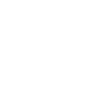